<a href="https://colab.research.google.com/github/Lahlukap669/DogVisionDeepLearningTensorFlow/blob/main/end_to_end_dog_vision.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 🐶 End to end multiclass dog breed classification

This notebook builds an end-to-end multi-class image classifier using Tenserflow 2.0 and Tensorflow Hub

## Problem

Indentifying the breed of a dog given an image of a dog.

When im sitting at a cafe and take a photo of a dog, I want to know what breed of dog it is.

## Data

The data we're using is from Kaggle's dog breed indentification competition.

https://www.kaggle.com/c/dog-breed-identification/data

## Evaluation

The evaluation is a file with a prediction probabilities with each dog breed of each test image.

https://www.kaggle.com/c/dog-breed-identification/overview

## Features

Some info about the data:

* We're dealing with images (unstructured data) so its probably best we use deep learning/ transfer learning
* There are 120 breeds of dogs (this means there are 120 different classes)
* There are around 10000+ images in the training set (these images have labels)
* There are around 10000+ images in the test set (these images have no labels, because we want to predict them)


In [ ]:
# unzip uploaded data in googleDrive
#!unzip "drive/MyDrive/dog_vision/train.zip" -d "drive/MyDrive/dog_vision"

### Get your workspace ready

* import TensorFlow 2.x ✅
* import TnsorFlow Hub ✅
* Make sure we're using a GPU ✅

In [ ]:
# import necessary tools
import tensorflow as tf
import tensorflow_hub as hub
print("TF version:", tf.__version__)
print("TF version:", hub.__version__)

# check for GPU avaliability
print("GPU", "avalible (YESSSSS!!!!!!)" if tf.config.list_physical_devices("GPU") else "Not avalible :(")

TF version: 2.15.0
TF version: 0.16.1
GPU avalible (YESSSSS!!!!!!)


## Getting our data ready

With all ML models, our dta has to be in numerical format. We will turn images to tensors.

Let's start by accesing our data and checking out the labels.

In [ ]:
# Checkout the labels of our data
import pandas as pd
labels_csv = pd.read_csv("drive/MyDrive/dog_vision/labels.csv")
print(labels_csv.describe())
labels_csv.head()

                                      id               breed
count                              10222               10222
unique                             10222                 120
top     fff43b07992508bc822f33d8ffd902ae  scottish_deerhound
freq                                   1                 126


,id,breed
0,000bec180eb18c7604dcecc8fe0dba07,boston_bull
1,001513dfcb2ffafc82cccf4d8bbaba97,dingo
2,001cdf01b096e06d78e9e5112d419397,pekinese
3,00214f311d5d2247d5dfe4fe24b2303d,bluetick
4,0021f9ceb3235effd7fcde7f7538ed62,golden_retriever


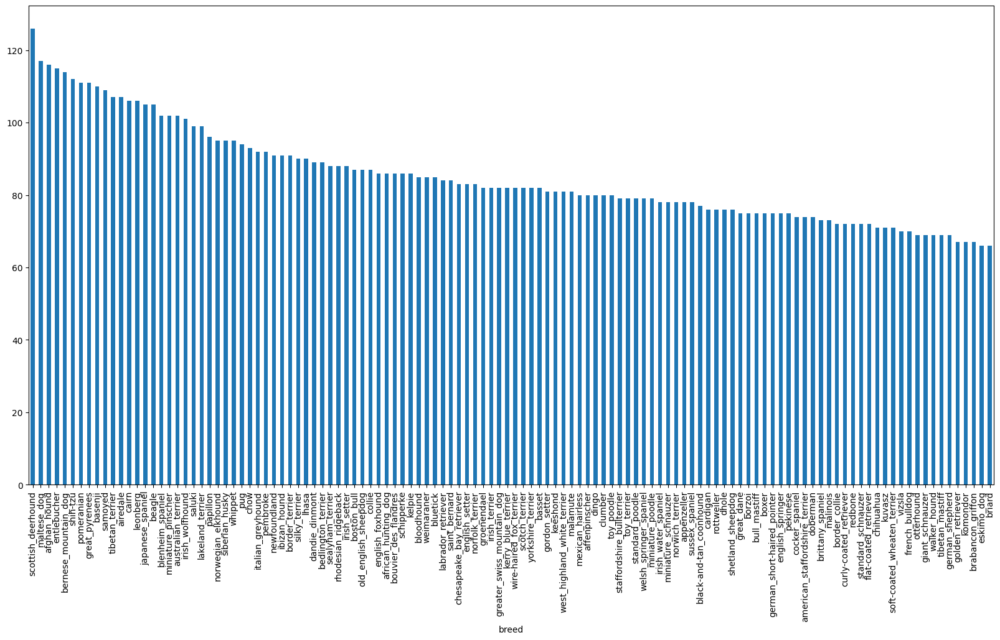

In [ ]:
# How many images are there of each breed
labels_csv["breed"].value_counts().plot.bar(figsize=(20, 10));

In [ ]:
labels_csv["breed"].value_counts().median()

82.0

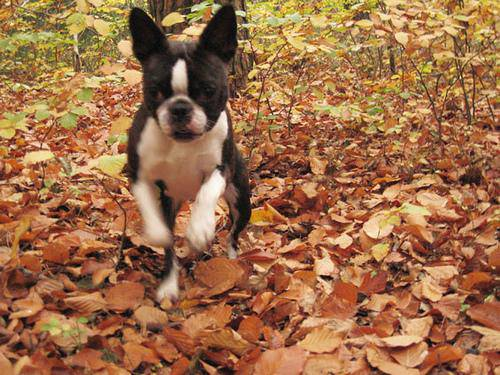

In [ ]:
# how to view image
from IPython.display import Image
Image("drive/MyDrive/dog_vision/train/000bec180eb18c7604dcecc8fe0dba07.jpg")

### Getting images and their labels

Let's get a list of all of our image file pathnames

In [ ]:
# Create pathnames from image ID's
filenames = ["drive/MyDrive/dog_vision/train/" + fname + ".jpg" for fname in labels_csv["id"]]

# Check the first 10
filenames[:10]

['drive/MyDrive/dog_vision/train/000bec180eb18c7604dcecc8fe0dba07.jpg',
 'drive/MyDrive/dog_vision/train/001513dfcb2ffafc82cccf4d8bbaba97.jpg',
 'drive/MyDrive/dog_vision/train/001cdf01b096e06d78e9e5112d419397.jpg',
 'drive/MyDrive/dog_vision/train/00214f311d5d2247d5dfe4fe24b2303d.jpg',
 'drive/MyDrive/dog_vision/train/0021f9ceb3235effd7fcde7f7538ed62.jpg',
 'drive/MyDrive/dog_vision/train/002211c81b498ef88e1b40b9abf84e1d.jpg',
 'drive/MyDrive/dog_vision/train/00290d3e1fdd27226ba27a8ce248ce85.jpg',
 'drive/MyDrive/dog_vision/train/002a283a315af96eaea0e28e7163b21b.jpg',
 'drive/MyDrive/dog_vision/train/003df8b8a8b05244b1d920bb6cf451f9.jpg',
 'drive/MyDrive/dog_vision/train/0042188c895a2f14ef64a918ed9c7b64.jpg']

In [ ]:
# Check wether a number of file names matches number of actual image files
import os
if len(os.listdir("drive/MyDrive/dog_vision/train/")) == len(filenames):
  print("Filenames match actual amount of files!!!")
else:
  print("Filenames DON'T match actual amount of files!!!")

Filenames match actual amount of files!!!


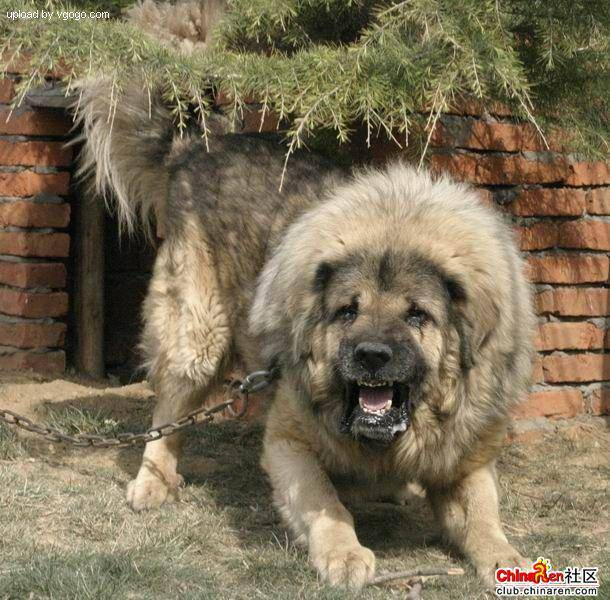

In [ ]:
# One more check
Image(filenames[9000])

In [ ]:
labels_csv["breed"][9000]

'tibetan_mastiff'

Now we've got our image filepaths together, let's get the labels.

We'll take them from labels_csv and turn them into a NumPy array.

In [ ]:
import numpy as np
labels = labels_csv["breed"]
labels = np.array(labels)
labels

array(['boston_bull', 'dingo', 'pekinese', ..., 'airedale',
       'miniature_pinscher', 'chesapeake_bay_retriever'], dtype=object)

In [ ]:
len(labels)

10222

In [ ]:
# See if number of labels matches a number of filenames
if len(labels) == len(filenames):
  print("It matches")
else:
  print("it doesnt match")

It matches


In [ ]:
# Find the unique label values
unique_breeds = np.unique(labels)
len(unique_breeds)

120

In [ ]:
# Turn every label into  a boolean array
boolean_labels = [label == unique_breeds for label in labels]
len(boolean_labels)

10222

In [ ]:
# Example: Turning boolean array into integers
print(labels[0]) #original label
print(np.where(unique_breeds == labels[0])) # index where label occurs
print(boolean_labels[0].argmax()) # index where label occurs in boolean array
print(boolean_labels[0].astype(int)) # there will be a 1 where the sample label occurs

boston_bull
(array([19]),)
19
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0]


### Creating our own validation set

Since the dataset from kaggle doesn't come with validation set we are going to create our own...

In [ ]:
# Setup X and y variables
X = filenames
y = boolean_labels

In [ ]:
# Set number of images to use for experimenting
NUM_IMAGES = 10000 #@param @{type:"slider", min:1000, max:10000}

In [ ]:
# Let's split our data
from sklearn.model_selection import train_test_split
X_train, X_val, y_train, y_val = train_test_split(X[:NUM_IMAGES], y[:NUM_IMAGES], test_size=0.2, random_state=42)
len(X_train), len(y_train), len(X_val), len(y_val)

(8000, 8000, 2000, 2000)

In [ ]:
# Let's have a geez at the training data
X_train[:2], y_train[:2]

(['drive/MyDrive/dog_vision/train/e86be20abe3ab746179728fa6f19bc59.jpg',
  'drive/MyDrive/dog_vision/train/269a6aeefd8050aafda02044c9cd2a80.jpg'],
 [array([False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
          True, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, Fal

## Preprocessing images (turning images into tensors)

Our labels are in numeric format but our images are still just file paths.

Since we're using TensorFlow, our data has to be in the form of Tensors.

A Tensor is a way to represent information in numbers. If you're familar with NumPy arrays (you should be), a Tensor can be thought of as a combination of NumPy arrays, except with the special ability to be used on a GPU.

Because of how TensorFlow stores information (in Tensors), it allows machine learning and deep learning models to be run on GPUs (generally faster at numerical computing).

To preprocess our images into Tensors we're going to write a function which does a few things:
1. Take an image filepath as input
2. Use TensorFlow to read the file and save it to a variable, `image`
3. Turn our `image` (a jpg file) into tensors
4. Resize the `image` to be a shape of (224, 224)
5. Return modified image

A good place to read about this type of function is the https://www.tensorflow.org/tutorials/load_data/images

You might be wondering why (224, 224), which is (heigh, width). It's because this is the size of input our model (we'll see this soon) takes, an image which is (224, 224, 3).

What? Where's the 3 from? We're getting ahead of ourselves but that's the number of colour channels per pixel, red, green and blue.

Let's make this a little more concrete.

In [ ]:
# Convert image to NumPy array
from matplotlib.pyplot import imread
image = imread(filenames[42]) # read in an image
image.shape

(257, 350, 3)

In [ ]:
# turn image into a tensor
tf.constant(image)[:2]

<tf.Tensor: shape=(2, 350, 3), dtype=uint8, numpy=
array([[[ 89, 137,  89],
        [ 76, 124,  76],
        [ 63, 111,  61],
        ...,
        [ 77, 133,  86],
        [ 76, 134,  86],
        [ 76, 134,  86]],

       [[ 72, 119,  75],
        [ 67, 114,  68],
        [ 63, 110,  64],
        ...,
        [ 75, 131,  84],
        [ 74, 132,  84],
        [ 74, 132,  84]]], dtype=uint8)>

In [ ]:
# Define image size
IMG_SIZE = 224

def process_image(image_path):
  """
  Takes an image file path and turns it into a Tensor.
  """
  # Read in image file
  image = tf.io.read_file(image_path)
  # Turn the jpeg image into numerical Tensor with 3 colour channels (Red, Green, Blue)
  image = tf.image.decode_jpeg(image, channels=3)
  # Convert the colour channel values from 0-225 values to 0-1 values - NORMALIZATION
  image = tf.image.convert_image_dtype(image, tf.float32)
  # Resize the image to our desired size (224, 244)
  image = tf.image.resize(image, size=[IMG_SIZE, IMG_SIZE])
  return image

### Creating data batches

Wonderful. Now we've got a function to convert our images into Tensors, we'll now build one to turn our data into batches (more specifically, a TensorFlow `BatchDataset`).

What's a batch?

A batch (also called mini-batch) is a small portion of your data, say 32 (32 is generally the default batch size) images and their labels. In deep learning, instead of finding patterns in an entire dataset at the same time, you often find them one batch at a time.

Let's say you're dealing with 10,000+ images (which we are). Together, these files may take up more memory than your GPU has. Trying to compute on them all would result in an error.

Instead, it's more efficient to create smaller batches of your data and compute on one batch at a time.

TensorFlow is very efficient when your data is in batches of (image, label) Tensors. So we'll build a function to do create those first. We'll take advantage of of `process_image` function at the same time.

In [ ]:
# Create a simple function to return a tuple (image, label)
def get_image_label(image_path, label):
  """
  Takes an image file path name and the associated label,
  processes the image and returns a tuple of (image, label).
  """
  image = process_image(image_path)
  return image, label

Now we've got a simple function to turn our image file path names and their associated labels into tuples (we can turn these into Tensors next), we'll create a function to make data batches.

Because we'll be dealing with 3 different sets of data (training, validation and test), we'll make sure the function can accomodate for each set.

We'll set a default batch size of 32 because according to Yann Lecun (one of the OG's of deep learning), friends don't let friends train with batch sizes over 32.

In [ ]:
# Define the batch size, 32 is a good default
BATCH_SIZE = 32

# Create a function to turn data into batches
def create_data_batches(x, y=None, batch_size=BATCH_SIZE, valid_data=False, test_data=False):
  """
  Creates batches of data out of image (x) and label (y) pairs.
  Shuffles the data if it's training data but doesn't shuffle it if it's validation data.
  Also accepts test data as input (no labels).
  """
  # If the data is a test dataset, we probably don't have labels
  if test_data:
    print("Creating test data batches...")
    data = tf.data.Dataset.from_tensor_slices((tf.constant(x))) # only filepaths
    data_batch = data.map(process_image).batch(BATCH_SIZE)
    return data_batch

  # If the data if a valid dataset, we don't need to shuffle it
  elif valid_data:
    print("Creating validation data batches...")
    data = tf.data.Dataset.from_tensor_slices((tf.constant(x), # filepaths
                                               tf.constant(y))) # labels
    data_batch = data.map(get_image_label).batch(BATCH_SIZE)
    return data_batch

  else:
    # If the data is a training dataset, we shuffle it
    print("Creating training data batches...")
    # Turn filepaths and labels into Tensors
    data = tf.data.Dataset.from_tensor_slices((tf.constant(x), # filepaths
                                              tf.constant(y))) # labels

    # Shuffling pathnames and labels before mapping image processor function is faster than shuffling images
    data = data.shuffle(buffer_size=len(x))

    # Create (image, label) tuples (this also turns the image path into a preprocessed image)
    data = data.map(get_image_label)

    # Turn the data into batches
    data_batch = data.batch(BATCH_SIZE)
  return data_batch

In [ ]:
# Create training and validation data batches
train_data = create_data_batches(X_train, y_train)
val_data = create_data_batches(X_val, y_val, valid_data=True)

Creating training data batches...
Creating validation data batches...


In [ ]:
# Check out the different attributes of our data batches
train_data.element_spec, val_data.element_spec

((TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)),
 (TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)))

Look at that! We've got our data in batches, more specifically, they're in Tensor pairs of (images, labels) ready for use on a GPU.

But having our data in batches can be a bit of a hard concept to understand. Let's build a function which helps us visualize what's going on under the hood.

### Visualizing data batches

In [ ]:
import matplotlib.pyplot as plt

# Create a function for viewing images in a data batch
def show_25_images(images, labels):
  """
  Displays 25 images from a data batch.
  """
  # Setup the figure
  plt.figure(figsize=(10, 10))
  # Loop through 25 (for displaying 25 images)
  for i in range(25):
    # Create subplots (5 rows, 5 columns)
    ax = plt.subplot(5, 5, i+1)
    # Display an image
    plt.imshow(images[i])
    # Add the image label as the title
    plt.title(unique_breeds[labels[i].argmax()])
    # Turn gird lines off
    plt.axis("off")

To make computation efficient, a batch is a tighly wound collection of Tensors.

So to view data in a batch, we've got to unwind it.

We can do so by calling the `as_numpy_iterator()` method on a data batch.

This will turn our a data batch into something which can be iterated over.

Passing an iterable to `next()` will return the next item in the iterator.

In our case, next will return a batch of 32 images and label pairs.

**Note:** Running the cell below and loading images may take a little while.

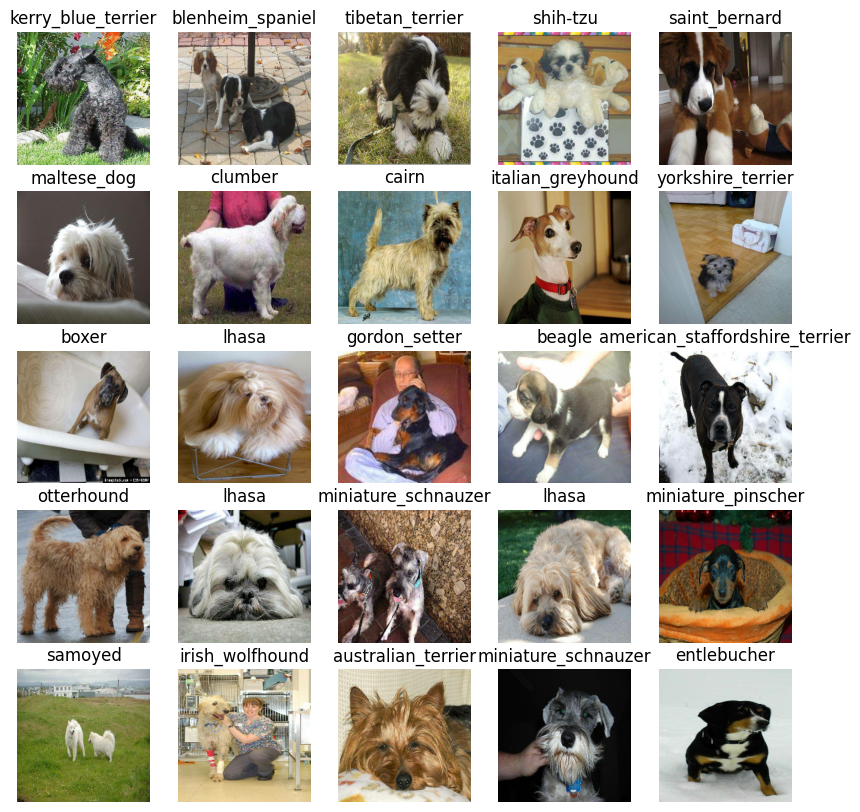

In [ ]:
# Visualize training images from the training data batch
train_images, train_labels = next(train_data.as_numpy_iterator())
show_25_images(train_images, train_labels)

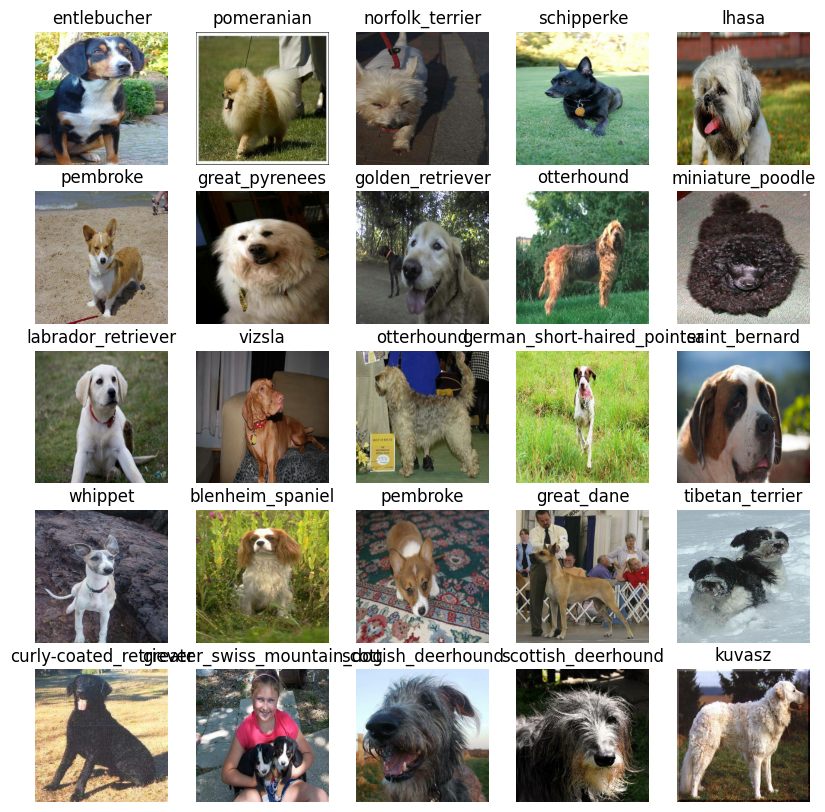

In [ ]:
# Visualize validation images from the validation data batch
val_images, val_labels = next(val_data.as_numpy_iterator())
show_25_images(val_images, val_labels)

Even more dogs!

Question: Why does running the cell above and viewing validation images return the same dogs each time?

## Creating and training a model

Now our data is ready, let's prepare it modelling. We'll use an existing model from https://www.kaggle.com/models?tfhub-redirect=true .

TensorFlow Hub is a resource where you can find pretrained machine learning models for the problem you're working on.

Using a pretrained machine learning model is often referred to as **transfer learning**.

**Why use a pretrained model?**

Building a machine learning model and training it on lots from scratch can be expensive and time consuming.

Transfer learning helps eliviate some of these by taking what another model has learned and using that information with your own problem.

**How do we choose a model?**

Since we know our problem is image classification (classifying different dog breeds), we can navigate the TensorFlow Hub page by our problem domain (image) https://www.kaggle.com/models?query=image-augmentation,image-classification,image-feature-vector,image-generator,image-object-detection,image-others,image-style-transfer,image-rnn-agent&tfhub-redirect=true .

We start by choosing the image problem domain, and then can filter it down by subdomains, in our case, image classification (https://www.kaggle.com/models?task=16686&tfhub-redirect=true).

Doing this gives a list of different pretrained models we can apply to our task.

Clicking on one gives us information about the model as well as instructions for using it.

For example, clicking on the mobilenet_v2_130_224 model (https://www.kaggle.com/models/google/mobilenet-v2/tensorFlow2/130-224-classification/1?tfhub-redirect=true), tells us this model takes an input of images in the shape 224, 224. It also says the model has been trained in the domain of image classification.

Let's try it out.

### Building a model

Before we build a model, there are a few things we need to define:

* The input shape (images, in the form of Tensors) to our model.
* The output shape (image labels, in the form of Tensors) of our model.
* The URL of the model we want to use.

These things will be standard practice with whatever machine learning model you use. And because we're using TensorFlow, everything will be in the form of Tensors.

In [ ]:
# Setup input shape to the model
INPUT_SHAPE = [None, IMG_SIZE, IMG_SIZE, 3] # batch, height, width, colour channels

# Setup output shape of the model
OUTPUT_SHAPE = len(unique_breeds) # number of unique labels

# Setup model URL from TensorFlow Hub
MODEL_URL = "https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4"

Now we've got the inputs, outputs and model we're using ready to go. We can start to put them together

There are many ways of building a model in TensorFlow but one of the best ways to get started is to use the Keras API (https://www.tensorflow.org/guide/keras).

Defining a deep learning model in Keras can be as straightforward as saying, "here are the layers of the model, the input shape and the output shape, let's go!"

Knowing this, let's create a function which:

* Takes the input shape, output shape and the model we've chosen's URL as parameters.
* Defines the layers in a Keras model in a sequential fashion (do this first, then this, then that).
* Compiles the model (says how it should be evaluated and improved).
* Builds the model (tells it what kind of input shape it'll be getting).
* Returns the model.

We'll take a look at the code first, then dicuss each part.

In [ ]:
# Create a function which builds a Keras model
def create_model(input_shape=INPUT_SHAPE, output_shape=OUTPUT_SHAPE, model_url=MODEL_URL):
  print("Building model with:", MODEL_URL)

  # Setup the model layers
  model = tf.keras.Sequential([
    hub.KerasLayer(MODEL_URL), # Layer 1 (input layer)
    tf.keras.layers.Dense(units=OUTPUT_SHAPE,
                          activation="softmax") # Layer 2 (output layer)
  ])

  # Compile the model
  model.compile(
      loss=tf.keras.losses.CategoricalCrossentropy(), # Our model wants to reduce this (how wrong its guesses are)
      optimizer=tf.keras.optimizers.Adam(), # A friend telling our model how to improve its guesses
      metrics=["accuracy"] # We'd like this to go up
  )

  # Build the model
  model.build(INPUT_SHAPE) # Let the model know what kind of inputs it'll be getting

  return model

In [ ]:
model = create_model()
model.summary()

Building model with: https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 keras_layer (KerasLayer)    (None, 1001)              5432713   
                                                                 
 dense (Dense)               (None, 120)               120240    
                                                                 
Total params: 5552953 (21.18 MB)
Trainable params: 120240 (469.69 KB)
Non-trainable params: 5432713 (20.72 MB)
_________________________________________________________________


In [ ]:
outputs = np.ones(shape=(1, 1, 1280))
outputs

array([[[1., 1., 1., ..., 1., 1., 1.]]])

### Non-trainable vs. Trainable Parameters

The **non-trainable parameters** are the patterns learned by `mobilenet_v2_130_224` and the **trainable parameters** are the ones in the dense layer we added.

This means the main bulk of the information in our model has already been learned, and we're going to take that and adapt it to our own problem.

### Creating Callbacks

We've got a model ready to go, but before we train it, we'll make some callbacks.

Callbacks are helper functions a model can use during training to do things such as save a model's progress, check a model's progress, or stop training early if a model stops improving.

The two callbacks we're going to add are a **TensorBoard callback** and an **Early Stopping callback**.

#### TensorBoard Callback

TensorBoard helps provide a visual way to monitor the progress of your model during and after training. It can be used directly in a notebook to track the performance measures of a model, such as loss and accuracy.

To set up a TensorBoard callback and view TensorBoard in a notebook, we need to do three things:

1. Load the TensorBoard notebook extension.
2. Create a TensorBoard callback which is able to save logs to a directory and pass it to our model's `fit()` function.
3. Visualize our model's training logs using the `%tensorboard` magic function (we'll do this later on).


In [ ]:
# Load the TensorBoard notebook extension
%load_ext tensorboard

In [ ]:
import datetime

# Create a function to build a TensorBoard callback
def create_tensorboard_callback():
  # Create a log directory for storing TensorBoard logs
  logdir = os.path.join("drive/My Drive/Data/logs",
                        # Make it so the logs get tracked whenever we run an experiment
                        datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
  return tf.keras.callbacks.TensorBoard(logdir)

#### Early Stopping Callback

Early stopping helps prevent overfitting by stopping a model when a certain evaluation metric stops improving. If a model trains for too long, it can do so well at finding patterns in a certain dataset that it's not able to use those patterns on another dataset it hasn't seen before (doesn't generalize).

It's basically like saying to our model, "keep finding patterns until the quality of those patterns starts to go down."


In [ ]:
# Create early stopping (once our model stops improving, stop training)
early_stopping = tf.keras.callbacks.EarlyStopping(monitor="val_accuracy",
                                                  patience=3) # stops after 3 rounds of no improvements

### Training a Model (on a Subset of Data)

Our first model is only going to be trained on 1000 images. It will be trained on 800 images and then validated on 200 images, meaning 1000 images total or about 10% of the total data.

We do this to make sure everything is working. If it is, we can step it up later and train on the entire training dataset.

The final parameter we'll define before training is `NUM_EPOCHS` (also known as the number of epochs).

`NUM_EPOCHS` defines how many passes of the data we'd like our model to do. A pass is equivalent to our model trying to find patterns in each dog image and see which patterns relate to each label.

If `NUM_EPOCHS=1`, the model will only look at the data once and will probably score badly because it hasn't had a chance to correct itself. It would be like you competing in the international hill descent championships and your friend Adam only being able to give you one single instruction to get down the hill.

#### What's a Good Value for `NUM_EPOCHS`?

This one is hard to say. 10 could be a good start but so could 100. This is one of the reasons we created an early stopping callback. Having early stopping setup means if we set `NUM_EPOCHS` to 100 but our model stops improving after 22 epochs, it'll stop training.

Along with this, let's quickly check if we're still using a GPU.


In [ ]:
# Check again if GPU is available (otherwise computing will take a looooonnnnggggg time)
print("GPU", "available (YESS!!!!)" if tf.config.list_physical_devices("GPU") else "not available :(")

GPU available (YESS!!!!)


In [ ]:
# How many rounds should we get the model to look through the data?
NUM_EPOCHS = 100 #@param {type:"slider", min:10, max:100, step:10}

Boom! We've got a GPU running and `NUM_EPOCHS` set up. Let's create a simple function to train a model. The function will:

1. Create a model using `create_model()`.
2. Set up a TensorBoard callback using `create_tensorboard_callback()` (we do this here so it creates a log directory of the current date and time).
3. Call the `fit()` function on our model, passing it the training data, validation data, number of epochs to train for, and the callbacks we'd like to use.
4. Return the fitted model.

In [ ]:
# Build a function to train and return a trained model
def train_model():
  """
  Trains a given model and returns the trained version.
  """
  # Create a model
  model = create_model()

  # Create new TensorBoard session everytime we train a model
  tensorboard = create_tensorboard_callback()

  # Fit the model to the data passing it the callbacks we created
  model.fit(x=train_data,
            epochs=NUM_EPOCHS,
            validation_data=val_data,
            validation_freq=1, # check validation metrics every epoch
            callbacks=[tensorboard, early_stopping])

  return model

**Note**: When training a model for the first time, the first epoch will take a while to load compared to the rest. This is because the model is getting ready and the data is being initialised. Using more data will generally take longer, which is why we've started with ~1000 images. After the first epoch, subsequent epochs should take a few seconds.

In [ ]:
# Fit the model to the data
model = train_model()

Building model with: https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4
Epoch 1/100
250/250 [==============================] - 186s 531ms/step - loss: 1.5226 - accuracy: 0.6360 - val_loss: 0.7149 - val_accuracy: 0.7885
Epoch 2/100
250/250 [==============================] - 47s 190ms/step - loss: 0.4055 - accuracy: 0.8840 - val_loss: 0.6680 - val_accuracy: 0.8055
Epoch 3/100
250/250 [==============================] - 45s 180ms/step - loss: 0.2317 - accuracy: 0.9429 - val_loss: 0.6559 - val_accuracy: 0.8000
Epoch 4/100
250/250 [==============================] - 44s 177ms/step - loss: 0.1454 - accuracy: 0.9680 - val_loss: 0.6462 - val_accuracy: 0.8050
Epoch 5/100
250/250 [==============================] - 44s 176ms/step - loss: 0.1003 - accuracy: 0.9822 - val_loss: 0.6453 - val_accuracy: 0.8085
Epoch 6/100
250/250 [==============================] - 43s 173ms/step - loss: 0.0710 - accuracy: 0.9901 - val_loss: 0.6581 - val_accuracy: 0.8035
Epoch 7/100
250/250 [=========

**Question**: It looks like our model might be overfitting (getting far better results on the training set than the validation set), what are some ways to prevent model overfitting? Hint: this may involve searching something like "ways to prevent overfitting in a deep learning model?".

**Note**: Overfitting to begin with is a good thing. It means our model is learning something.

### Checking the TensorBoard logs

Now our model has been trained, we can make its performance visual by checking the TensorBoard logs.

The TensorBoard magic function (`%tensorboard`) will access the logs directory we created earlier and viualize its contents.

In [ ]:
%tensorboard --logdir drive/MyDrive/Data/logs

<IPython.core.display.Javascript object>

Thanks to our `early_stopping` callback, the model stopped training after about 16 epochs (this may vary slightly for you). This is because the validation accuracy failed to improve for 3 epochs.

The good news is, we can see that our model is learning something. The validation accuracy reached 65% in only a few minutes.

This means if we were to scale up the number of images, we would hopefully see the accuracy increase.

### Making and Evaluating Predictions Using a Trained Model

Before we scale up and train on more data, let's explore other ways to evaluate our model. Although accuracy is a good indicator of how our model is performing, it would be even better to see it in action.

Making predictions with a trained model is as simple as calling `predict()` on it and passing it data in the same format the model was trained on.


In [ ]:
# Make predictions on the validation data (not used to train on)
predictions = model.predict(val_data, verbose=1) # verbose shows us how long there is to go
predictions

63/63 [==============================] - 351s 6s/step


array([[1.4396339e-03, 1.1094175e-03, 9.0418365e-03, ..., 4.4864118e-03,
        9.7696399e-03, 2.3966217e-03],
       [6.5953704e-03, 4.5081796e-03, 2.4685876e-03, ..., 4.8168417e-04,
        8.8453926e-03, 1.5821431e-02],
       [2.1251566e-03, 2.4901767e-04, 1.5819705e-03, ..., 2.0209864e-04,
        8.5675379e-04, 1.5650169e-03],
       ...,
       [1.7251050e-03, 4.4902279e-03, 4.5022392e-03, ..., 3.3937804e-03,
        1.7707035e-03, 6.2936521e-04],
       [2.7974690e-03, 7.7823540e-03, 2.0241885e-02, ..., 1.7158389e-02,
        4.0537654e-03, 4.6637570e-03],
       [1.2719622e-02, 3.0862421e-03, 1.7946687e-03, ..., 7.2957911e-05,
        5.9642503e-04, 1.4164898e-03]], dtype=float32)

In [ ]:
# Check the shape of predictions
predictions.shape

(2000, 120)

Making predictions with our model returns an array with a different value for each label.

In this case, making predictions on the validation data (200 images) returns an array (`predictions`) of arrays, each containing 120 different values (one for each unique dog breed).

These different values are the probabilities or the likelihood the model has predicted a certain image being a certain breed of dog. The higher the value, the more likely the model thinks a given image is a specific breed of dog.

Let's see how we'd convert an array of probabilities into an actual label.

In [ ]:
# First prediction
print(predictions[0])
print(f"Max value (probability of prediction): {np.max(predictions[0])}") # the max probability value predicted by the model
print(f"Sum: {np.sum(predictions[0])}") # because we used softmax activation in our model, this will be close to 1
print(f"Max index: {np.argmax(predictions[0])}") # the index of where the max value in predictions[0] occurs
print(f"Predicted label: {unique_breeds[np.argmax(predictions[0])]}") # the predicted label

[0.00143963 0.00110942 0.00904184 0.00131883 0.00408876 0.0128196
 0.00084501 0.00213183 0.00167532 0.00851383 0.00159097 0.01767718
 0.00198767 0.00669378 0.00705334 0.00549773 0.00033436 0.02070388
 0.00373004 0.00134868 0.00201541 0.00366141 0.00925876 0.00418711
 0.02365864 0.0040515  0.0013957  0.00228739 0.04006686 0.00327617
 0.00715323 0.00164305 0.00621554 0.00073796 0.00195298 0.00641723
 0.00649382 0.00145483 0.00214842 0.01640523 0.00557795 0.00526576
 0.00594989 0.00060647 0.00361546 0.00678344 0.0028586  0.00729347
 0.00457719 0.01101976 0.03177807 0.00513734 0.00085398 0.00485155
 0.00247662 0.00406183 0.00942789 0.00909086 0.01350003 0.00152558
 0.00733364 0.01051763 0.00046136 0.00057291 0.01024751 0.00363938
 0.00443461 0.00637628 0.02142099 0.0106245  0.00630244 0.00129236
 0.00301894 0.00227471 0.00931308 0.0290669  0.02325844 0.01368102
 0.00110523 0.00565033 0.00396963 0.0011913  0.00961887 0.00707049
 0.00033939 0.00346733 0.00748231 0.00249263 0.00312653 0.00209

Having this information is great but it would be even better if we could compare a prediction to its true label and original image.

To help us, let's first build a little function to convert prediction probabilities into predicted labels.

Note: Prediction probabilities are also known as confidence levels.

In [ ]:
# Turn prediction probabilities into their respective label (easier to understand)
def get_pred_label(prediction_probabilities):
  """
  Turns an array of prediction probabilities into a label.
  """
  return unique_breeds[np.argmax(prediction_probabilities)]

# Get a predicted label based on an array of prediction probabilities
pred_label = get_pred_label(predictions[0])
pred_label

'silky_terrier'

Wonderful! Now that we've got a list of all the different predictions our model has made, we'll do the same for the validation images and validation labels.

Remember, the model hasn't trained on the validation data; during the `fit()` function, it only used the validation data to evaluate itself. So we can use the validation images to visually compare our model's predictions with the validation labels.

Since our validation data (`val_data`) is in batch form, to get a list of validation images and labels, we'll have to unbatch it (using `unbatch()`) and then turn it into an iterator using `as_numpy_iterator()`.

Let's make a small function to do so.


In [ ]:
# Create a function to unbatch a batched dataset
def unbatchify(data):
  """
  Takes a batched dataset of (image, label) Tensors and returns separate arrays
  of images and labels.
  """
  images = []
  labels = []
  # Loop through unbatched data
  for image, label in data.unbatch().as_numpy_iterator():
    images.append(image)
    labels.append(unique_breeds[np.argmax(label)])
  return images, labels

# Unbatchify the validation data
val_images, val_labels = unbatchify(val_data)
val_images[0], val_labels[0]

(array([[[0.96884924, 0.9701885 , 0.6773138 ],
         [0.9649684 , 0.9649684 , 0.6752449 ],
         [0.97255224, 0.97255224, 0.6897149 ],
         ...,
         [0.94544876, 0.93533266, 0.63851905],
         [0.9122807 , 0.90027964, 0.59165734],
         [0.6266023 , 0.6167168 , 0.30141547]],
 
        [[0.9636907 , 0.9677085 , 0.69290984],
         [0.97148985, 0.97514886, 0.7090773 ],
         [0.9998248 , 0.99992114, 0.74782914],
         ...,
         [0.97280353, 0.9686894 , 0.715118  ],
         [0.9849285 , 0.99132735, 0.7000457 ],
         [0.8505023 , 0.8618907 , 0.55982476]],
 
        [[0.94763345, 0.9589167 , 0.70516145],
         [0.96966976, 0.9795524 , 0.73575866],
         [0.9953722 , 0.99858195, 0.7804973 ],
         ...,
         [0.8728771 , 0.8872267 , 0.69398195],
         [0.8451019 , 0.8824005 , 0.6274633 ],
         [0.7930096 , 0.83910555, 0.5551244 ]],
 
        ...,
 
        [[0.47171637, 0.37899917, 0.3959688 ],
         [0.23060554, 0.1464493 , 0.15993

Nailed it!

Now we've got ways to get:

- Prediction labels
- Validation labels (truth labels)
- Validation images

Let's make some functions to visualize these more effectively.

More specifically, we want to be able to view an image, its predicted label, and its actual label (true label).

The first function we'll create will:

1. Take an array of prediction probabilities, an array of truth labels, an array of images, and an integer.
2. Convert the prediction probabilities to a predicted label.
3. Plot the predicted label, its predicted probability, the truth label, and the target image on a single plot.


In [ ]:
def plot_pred(prediction_probabilities, labels, images, n=1):
  """
  View the prediction, ground truth label and image for sample n.
  """
  pred_prob, true_label, image = prediction_probabilities[n], labels[n], images[n]

  # Get the pred label
  pred_label = get_pred_label(pred_prob)

  # Plot image & remove ticks
  plt.imshow(image)
  plt.xticks([])
  plt.yticks([])

  # Change the color of the title depending on if the prediction is right or wrong
  if pred_label == true_label:
    color = "green"
  else:
    color = "red"

  plt.title("{} {:2.0f}% ({})".format(pred_label,
                                      np.max(pred_prob)*100,
                                      true_label),
                                      color=color)

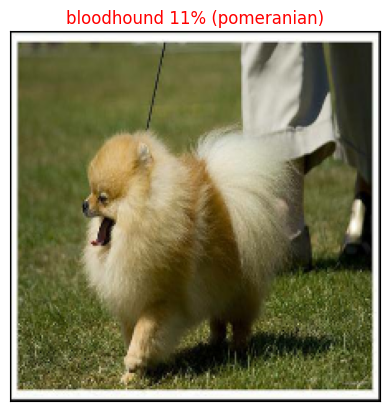

In [ ]:
# View an example prediction, original image and truth label
plot_pred(prediction_probabilities=predictions,
          labels=val_labels,
          images=val_images)

Nice! Making functions to help visualize your model's results is really helpful in understanding how your model is doing.

Since we're working with a multi-class problem (120 different dog breeds), it would also be good to see what other guesses our model is making. More specifically, if our model predicts a certain label with 24% probability, what else did it predict?

Let's build a function to demonstrate. The function will:

1. Take an input of a prediction probabilities array, a ground truth labels array, and an integer.
2. Find the predicted label using `get_pred_label()`.
3. Find the top 10:
   - Prediction probabilities indexes
   - Prediction probabilities values
   - Prediction labels
4. Plot the top 10 prediction probability values and labels, coloring the true label green.


In [ ]:
def plot_pred_conf(prediction_probabilities, labels, n=1):
  """
  Plots the top 10 highest prediction confidences along with
  the truth label for sample n.
  """
  pred_prob, true_label = prediction_probabilities[n], labels[n]

  # Get the predicted label
  pred_label = get_pred_label(pred_prob)

  # Find the top 10 prediction confidence indexes
  top_10_pred_indexes = pred_prob.argsort()[-10:][::-1]
  # Find the top 10 prediction confidence values
  top_10_pred_values = pred_prob[top_10_pred_indexes]
  # Find the top 10 prediction labels
  top_10_pred_labels = unique_breeds[top_10_pred_indexes]

  # Setup plot
  top_plot = plt.bar(np.arange(len(top_10_pred_labels)),
                     top_10_pred_values,
                     color="grey")
  plt.xticks(np.arange(len(top_10_pred_labels)),
             labels=top_10_pred_labels,
             rotation="vertical")

  # Change color of true label
  if np.isin(true_label, top_10_pred_labels):
    top_plot[np.argmax(top_10_pred_labels == true_label)].set_color("green")
  else:
    pass

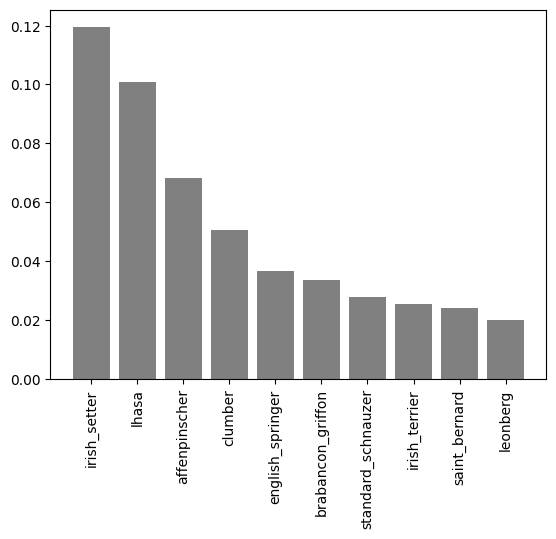

In [ ]:
plot_pred_conf(prediction_probabilities=predictions,
               labels=val_labels,
               n=9)

Wonderful! Now we've got some functions to help us visualize our predictions and evaluate our model, let's check out a few.

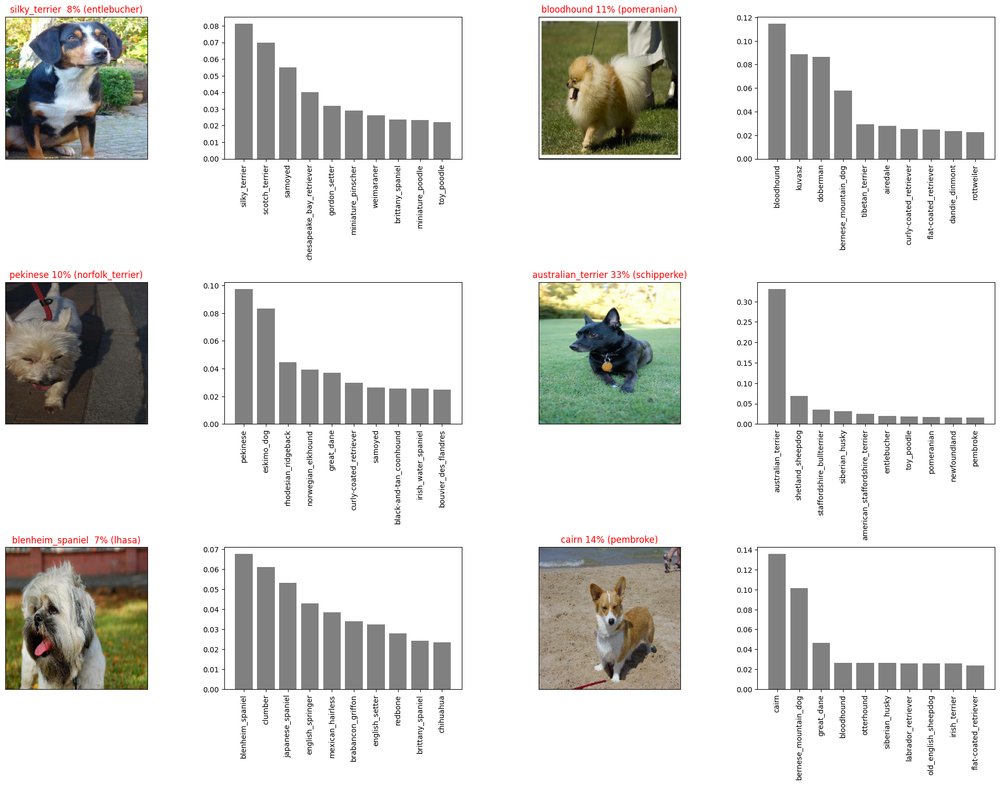

In [ ]:
# Let's check a few predictions and their different values
i_multiplier = 0
num_rows = 3
num_cols = 2
num_images = num_rows*num_cols
plt.figure(figsize=(5*2*num_cols, 5*num_rows))
for i in range(num_images):
  plt.subplot(num_rows, 2*num_cols, 2*i+1)
  plot_pred(prediction_probabilities=predictions,
            labels=val_labels,
            images=val_images,
            n=i+i_multiplier)
  plt.subplot(num_rows, 2*num_cols, 2*i+2)
  plot_pred_conf(prediction_probabilities=predictions,
                labels=val_labels,
                n=i+i_multiplier)
plt.tight_layout(h_pad=1.0)
plt.show()

### Saving and Reloading a Model

After training a model, it's a good idea to save it. Saving it means you can share it with colleagues, put it in an application, and more importantly, avoid the potentially expensive step of retraining it.

The format of an entire saved Keras model is `h5`. So, we'll make a function that can take a model as input and use the `save()` method to save it as an `h5` file to a specified directory.


In [ ]:
def save_model(model, suffix=None):
  """
  Saves a given model in a models directory and appends a suffix (str)
  for clarity and reuse.
  """
  # Create model directory with current time
  modeldir = os.path.join("drive/MyDrive/Data/models",
                          datetime.datetime.now().strftime("%Y%m%d-%H%M%s"))
  model_path = modeldir + "-" + suffix + ".h5" # save format of model
  print(f"Saving model to: {model_path}...")
  model.save(model_path)
  return model_path

If we've got a saved model, we'd like to load it. Let's create a function that can take a model path and use the `tf.keras.models.load_model()` function to load it into the notebook.

Because we're using a component from TensorFlow Hub (`hub.KerasLayer`), we'll have to pass this as a parameter to the `custom_objects` parameter.

In [ ]:
def load_model(model_path):
  """
  Loads a saved model from a specified path.
  """
  print(f"Loading saved model from: {model_path}")
  model = tf.keras.models.load_model(model_path,
                                     custom_objects={"KerasLayer":hub.KerasLayer})
  return model

In [ ]:
# Save our model trained on 1000 images
save_model(model, suffix="1000-images-Adam")

Saving model to: drive/MyDrive/Data/models/20240727-21431722116637-1000-images-Adam.h5...


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


'drive/MyDrive/Data/models/20240727-21431722116637-1000-images-Adam.h5'

In [ ]:
# Load our model trained on 1000 images
model_1000_images = load_model('drive/MyDrive/Data/models/20240724-16031721837007-1000-images-Adam.h5')

Loading saved model from: drive/MyDrive/Data/models/20240724-16031721837007-1000-images-Adam.h5


Compare the two models (the original one and loaded one). We can do so easily using the `evaluate()` method.

In [ ]:
# Evaluate the pre-saved model
model.evaluate(val_data)

63/63 [==============================] - 10s 154ms/step - loss: 0.6864 - accuracy: 0.8070


[0.6863770484924316, 0.8069999814033508]

In [ ]:
# Evaluate the loaded model
model_1000_images.evaluate(val_data)

63/63 [==============================] - 9s 140ms/step - loss: 1.2301 - accuracy: 0.6770


[1.2301037311553955, 0.6769999861717224]

### Training a Model (on the Full Data)

Now that we know our model works on a subset of the data, we can start to move forward with training one on the full data.

Above, we saved all of the training filepaths to `X` and all of the training labels to `y`. Let's check them out.


In [ ]:
# Remind ourselves of the size of the full dataset
len(X), len(y)

(10222, 10222)

There we go! We've got over 10,000 images and labels in our training set.

Before we can train a model on these, we'll have to turn them into a data batch.

The beautiful thing is, we can use our `create_data_batches()` function from above, which also preprocesses our images for us (thank you, past us, for writing a helpful function).

In [ ]:
# Turn full training data in a data batch
full_data = create_data_batches(X, y)

Creating training data batches...


Our data is in a data batch, all we need now is a model.

And surprise, we've got a function for that too! Let's use `create_model()` to instantiate another model.

In [ ]:
# Instantiate a new model for training on the full dataset
full_model = create_model()

Building model with: https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4


Since we've made a new model instance, `full_model`, we'll need some callbacks too.

In [ ]:
# Create full model callbacks

# TensorBoard callback
full_model_tensorboard = create_tensorboard_callback()

# Early stopping callback
# Note: No validation set when training on all the data, therefore can't monitor validation accruacy
full_model_early_stopping = tf.keras.callbacks.EarlyStopping(monitor="accuracy",
                                                             patience=3)

To monitor the model whilst it trains, we'll load TensorBoard (it should update every 30-seconds or so whilst the model trains).

In [ ]:
%tensorboard --logdir drive/MyDrive/Data/logs

Reusing TensorBoard on port 6006 (pid 7012), started 0:01:20 ago. (Use '!kill 7012' to kill it.)

<IPython.core.display.Javascript object>

Note: Since running the cell below will cause the model to train on all of the data (10,000+) images, it may take a fairly long time to get started and finish. However, thanks to our `full_model_early_stopping` callback, it'll stop before it starts going too long.

Remember, the first epoch is always the longest as data gets loaded into memory. After it's there, it'll speed up.

In [ ]:
# Fit the full model to the full training data
full_model.fit(x=full_data,
               epochs=NUM_EPOCHS,
               callbacks=[full_model_tensorboard,
                          full_model_early_stopping])

Epoch 1/100
320/320 [==============================] - 53s 153ms/step - loss: 1.3514 - accuracy: 0.6674
Epoch 2/100
320/320 [==============================] - 45s 140ms/step - loss: 0.4006 - accuracy: 0.8803
Epoch 3/100
320/320 [==============================] - 45s 141ms/step - loss: 0.2381 - accuracy: 0.9330
Epoch 4/100
320/320 [==============================] - 46s 144ms/step - loss: 0.1539 - accuracy: 0.9627
Epoch 5/100
320/320 [==============================] - 47s 146ms/step - loss: 0.1065 - accuracy: 0.9784
Epoch 6/100
320/320 [==============================] - 45s 140ms/step - loss: 0.0767 - accuracy: 0.9873
Epoch 7/100
320/320 [==============================] - 47s 147ms/step - loss: 0.0607 - accuracy: 0.9908
Epoch 8/100
320/320 [==============================] - 48s 149ms/step - loss: 0.0460 - accuracy: 0.9942
Epoch 9/100
320/320 [==============================] - 47s 148ms/step - loss: 0.0388 - accuracy: 0.9963
Epoch 10/100
320/320 [==============================] - 46s 143m

# Saving and Reloading the Full Model

Even on a GPU, our full model took a while to train. So it's a good idea to save it.

We can do so using our `save_model()` function.

**Challenge:** It may be a good idea to incorporate the `save_model()` function into a `train_model()` function. Or look into setting up a checkpoint callback.

In [ ]:
# Save model to file
save_model(full_model, suffix="all-images-Adam")

Saving model to: drive/MyDrive/Data/models/20240727-22091722118151-all-images-Adam.h5...


'drive/MyDrive/Data/models/20240727-22091722118151-all-images-Adam.h5'

In [ ]:
# Load in the full model
loaded_full_model = load_model('drive/MyDrive/Data/models/20240727-22091722118151-all-images-Adam.h5')

Loading saved model from: drive/MyDrive/Data/models/20240727-22091722118151-all-images-Adam.h5


# Making Predictions on the Test Dataset

Since our model has been trained on images in the form of Tensor batches, to make predictions on the test data, we'll have to get it into the same format.

Luckily we created `create_data_batches()` earlier which can take a list of filenames as input and convert them into Tensor batches.

To make predictions on the test data, we'll:

1. Get the test image filenames.
2. Convert the filenames into test data batches using `create_data_batches()` and setting the `test_data` parameter to `True` (since there are no labels with the test images).
3. Make a predictions array by passing the test data batches to the `predict()` function.

In [ ]:
# Load test image filenames (since we're using os.listdir(), these already have .jpg)
test_path = "drive/MyDrive/dog_vision/test/"
test_filenames = [test_path + fname for fname in os.listdir(test_path)]

test_filenames[:10]

['drive/MyDrive/dog_vision/test/000621fb3cbb32d8935728e48679680e.jpg',
 'drive/MyDrive/dog_vision/test/00102ee9d8eb90812350685311fe5890.jpg',
 'drive/MyDrive/dog_vision/test/0012a730dfa437f5f3613fb75efcd4ce.jpg',
 'drive/MyDrive/dog_vision/test/001510bc8570bbeee98c8d80c8a95ec1.jpg',
 'drive/MyDrive/dog_vision/test/001a5f3114548acdefa3d4da05474c2e.jpg',
 'drive/MyDrive/dog_vision/test/00225dcd3e4d2410dd53239f95c0352f.jpg',
 'drive/MyDrive/dog_vision/test/002c2a3117c2193b4d26400ce431eebd.jpg',
 'drive/MyDrive/dog_vision/test/002c58d413a521ae8d1a5daeb35fc803.jpg',
 'drive/MyDrive/dog_vision/test/002f80396f1e3db687c5932d7978b196.jpg',
 'drive/MyDrive/dog_vision/test/0036c6bcec6031be9e62a257b1c3c442.jpg']

In [ ]:
# How many test images are there?
len(test_filenames)

10357

In [ ]:
# Create test data batch
test_data = create_data_batches(test_filenames, test_data=True)

Creating test data batches...


In [ ]:
# Make predictions on test data batch using the loaded full model
test_predictions = loaded_full_model.predict(test_data,
                                             verbose=1)

324/324 [==============================] - 174s 537ms/step


In [ ]:
# Check out the test predictions
test_predictions[:10]

array([[8.4483554e-13, 5.6020824e-13, 1.1904941e-15, ..., 3.1759605e-14,
        1.4817869e-10, 1.5738522e-11],
       [4.1369344e-07, 4.8214793e-07, 5.8964975e-09, ..., 1.4177866e-11,
        3.2334814e-08, 3.5995359e-10],
       [8.0665509e-11, 2.1417024e-07, 3.4486085e-09, ..., 2.3981698e-07,
        5.3515525e-11, 1.7545550e-11],
       ...,
       [1.0012862e-09, 6.2564148e-11, 4.4060876e-11, ..., 6.7726662e-13,
        6.1145576e-13, 2.9976039e-11],
       [3.6845485e-11, 2.9084105e-10, 6.5101452e-11, ..., 3.7483693e-07,
        2.6131521e-09, 6.1120397e-12],
       [1.2742044e-09, 4.3815351e-12, 3.2607247e-11, ..., 1.1481784e-13,
        1.7552444e-12, 2.7846912e-08]], dtype=float32)

# Preparing Test Dataset Predictions for Kaggle

Looking at the Kaggle sample submission, it looks like they want the model's output probabilities for each label along with the image IDs.

To get the data in this format, we'll:

1. Create a pandas DataFrame with an `ID` column as well as a column for each dog breed.
2. Add data to the `ID` column by extracting the test image IDs from their filepaths.
3. Add data (the prediction probabilities) to each of the dog breed columns using the `unique_breeds` list and the `test_predictions` list.
4. Export the DataFrame as a CSV to submit it to Kaggle.

In [ ]:
# Create pandas DataFrame with empty columns
preds_df = pd.DataFrame(columns=["id"] + list(unique_breeds))
preds_df.head()

,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,...,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier


In [ ]:
# Append test image ID's to predictions DataFrame
test_path = "drive/MyDrive/dog_vision/test/"
preds_df["id"] = [os.path.splitext(path)[0] for path in os.listdir(test_path)]
preds_df.head()

,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,...,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier
0,000621fb3cbb32d8935728e48679680e,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,00102ee9d8eb90812350685311fe5890,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,0012a730dfa437f5f3613fb75efcd4ce,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,001510bc8570bbeee98c8d80c8a95ec1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,001a5f3114548acdefa3d4da05474c2e,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
# Add the prediction probabilities to each dog breed column
preds_df[list(unique_breeds)] = test_predictions
preds_df.head()

,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,...,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier
0,000621fb3cbb32d8935728e48679680e,8.448355e-13,5.602082e-13,1.190494e-15,6.534957e-14,8.610314e-14,3.414286e-12,7.871053e-17,1.593144e-13,1.593353e-14,...,4.722477e-13,2.923244e-14,1.202246e-14,7.696358e-15,6.852572e-15,3.717980e-13,8.143829e-14,3.175961e-14,1.481787e-10,1.573852e-11
1,00102ee9d8eb90812350685311fe5890,4.136934e-07,4.821479e-07,5.896498e-09,1.508134e-09,5.530163e-07,1.376825e-09,1.542010e-06,5.492986e-07,3.120082e-09,...,1.620386e-08,6.684488e-07,6.776789e-09,3.030683e-06,3.916679e-08,1.065663e-07,4.942080e-04,1.417787e-11,3.233481e-08,3.599536e-10
2,0012a730dfa437f5f3613fb75efcd4ce,8.066551e-11,2.141702e-07,3.448609e-09,3.638551e-11,5.886595e-11,1.406075e-08,2.097297e-12,2.963546e-12,2.467248e-09,...,2.549873e-12,3.052573e-12,1.043015e-07,1.677605e-07,1.435163e-07,1.073035e-08,6.639940e-13,2.398170e-07,5.351553e-11,1.754555e-11
3,001510bc8570bbeee98c8d80c8a95ec1,1.758546e-07,2.211542e-08,3.435354e-08,1.616457e-06,2.919128e-06,2.271655e-06,6.279283e-12,8.247282e-10,1.330447e-08,...,6.740406e-07,8.359755e-11,8.797747e-07,5.526557e-11,2.973336e-07,1.199510e-09,2.046665e-16,2.123329e-03,3.040694e-12,2.752965e-08
4,001a5f3114548acdefa3d4da05474c2e,9.837642e-05,3.753071e-06,1.510692e-08,1.357016e-09,1.839678e-09,4.086143e-11,2.305787e-10,5.189964e-09,1.177087e-08,...,1.259533e-07,3.997240e-11,5.262627e-11,5.012227e-11,6.379523e-11,8.435313e-10,5.917314e-11,8.864235e-08,1.398037e-10,2.390249e-08


In [ ]:
preds_df.to_csv("drive/MyDrive/Data/full_submission_1_mobilienetV2_adam.csv",
                 index=False)

# Making Predictions on Custom Images

It's great being able to make predictions on a test dataset already provided for us.

But how could we use our model on our own images?

The premise remains, if we want to make predictions on our own custom images, we have to pass them to the model in the same format the model was trained on.

To do so, we'll:

1. Get the filepaths of our own images.
2. Turn the filepaths into data batches using `create_data_batches()`. And since our custom images won't have labels, we set the `test_data` parameter to `True`.
3. Pass the custom image data batch to our model's `predict()` method.
4. Convert the prediction output probabilities to prediction labels.
5. Compare the predicted labels to the custom images.

**Note:** To make predictions on custom images, I've uploaded pictures of my own to a directory located at `drive/My Drive/Data/dogs/` (as seen in the cell below). In order to make predictions on your own images, you will have to do something similar.

In [ ]:
# Get custom image filepaths
custom_path = "drive/MyDrive/Data/dogs/"
custom_image_paths = [custom_path + fname for fname in os.listdir(custom_path)]

In [ ]:
# Turn custom image into batch (set to test data because there are no labels)
custom_data = create_data_batches(custom_image_paths, test_data=True)

Creating test data batches...


In [ ]:
# Make predictions on the custom data
custom_preds = loaded_full_model.predict(custom_data)

1/1 [==============================] - 4s 4s/step


Now we've got some predictions arrays, let's convert them to labels and compare them with each image.

In [ ]:
# Get custom image prediction labels
custom_pred_labels = [get_pred_label(custom_preds[i]) for i in range(len(custom_preds))]
custom_pred_labels

['pembroke', 'golden_retriever', 'groenendael', 'rottweiler']

In [ ]:
# Get custom images (our unbatchify() function won't work since there aren't labels)
custom_images = []
# Loop through unbatched data
for image in custom_data.unbatch().as_numpy_iterator():
  custom_images.append(image)

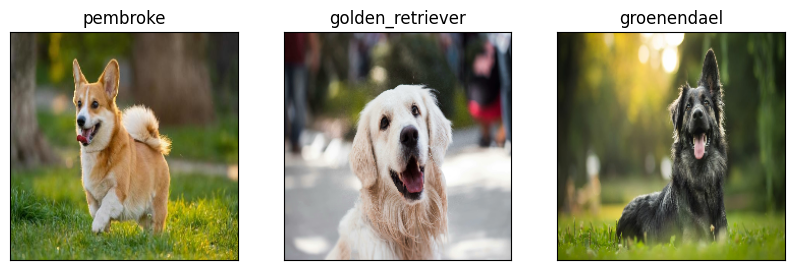

In [ ]:
# Check custom image predictions
plt.figure(figsize=(10, 10))
for i, image in enumerate(custom_images[0:3]):
  plt.subplot(1, 3, i+1)
  plt.xticks([])
  plt.yticks([])
  plt.title(custom_pred_labels[i])
  plt.imshow(image)